In [2]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsClassifier

### Chargeons notre dataset

In [3]:
df = pd.read_csv('data.csv')

## La taille du jeu de donnée

In [4]:
df.shape

(569, 33)

Le jeu de donné contient 569 lignes et 33 colonnes

In [5]:

df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


### Signification des variables

diagnosis (diagnostic): Il s'agit de la variable cible qui indique si la tumeur est bénigne (B) ou maligne (M).

radius_mean (rayon_moyen): La moyenne des distances du centre de la tumeur aux points sur le périmètre. C'est une mesure de la taille de la tumeur.

texture_mean (texture_moyenne): La moyenne des variations dans les valeurs de gris au sein de la tumeur. Cela mesure la rugosité ou la douceur de la tumeur.

perimeter_mean (périmètre_moyen): La moyenne du périmètre de la tumeur. Une autre mesure de la taille de la tumeur.

area_mean (surface_moyenne): La moyenne de la surface de la tumeur. Mesure de la taille de la tumeur en termes de surface.

smoothness_mean (douceur_moyenne): La moyenne des longueurs relatives des bords, mesurant la douceur des contours de la tumeur.

compactness_mean (compacité_moyenne): La moyenne des rapports entre le périmètre de la tumeur et la racine carrée de sa surface, mesurant à quel point la tumeur est compacte.

concavity_mean (concavité_moyenne): La moyenne de la concavité de la tumeur, c'est-à-dire la profondeur des cavités ou des indentations dans la tumeur.

concave points_mean (points_concaves_moyens): La moyenne du nombre de points concaves sur le contour de la tumeur.

symmetry_mean (symétrie_moyenne): La moyenne de la symétrie de la tumeur.

fractal_dimension_mean (dimension_fractale_moyenne): La moyenne de la dimension fractale de la tumeur, une mesure de la complexité des contours de la tumeur.

radius_se (écart_type_rayon): L'écart type des distances du centre aux points sur le périmètre, mesurant la variabilité de la taille de la tumeur.

texture_se (écart_type_texture): L'écart type des variations dans les valeurs de gris, mesurant la variabilité de la texture de la tumeur.

perimeter_se (écart_type_périmètre): L'écart type du périmètre de la tumeur.

area_se (écart_type_surface): L'écart type de la surface de la tumeur.

smoothness_se (écart_type_douceur): L'écart type de la douceur des contours de la tumeur.

compactness_se (écart_type_compacité): L'écart type de la compacité de la tumeur.

concavity_se (écart_type_concavité): L'écart type de la concavité de la tumeur.

concave points_se (écart_type_points_concaves): L'écart type du nombre de points concaves sur le contour de la tumeur.

symmetry_se (écart_type_symétrie): L'écart type de la symétrie de la tumeur.

fractal_dimension_se (écart_type_dimension_fractale): L'écart type de la dimension fractale de la tumeur.

radius_worst (rayon_le_pire): La plus grande valeur du rayon de la tumeur observée.

texture_worst (texture_le_pire): La plus grande valeur de la texture de la tumeur observée.

perimeter_worst (périmètre_le_pire): La plus grande valeur du périmètre de la tumeur observée.

area_worst (surface_le_pire): La plus grande valeur de la surface de la tumeur observée.

smoothness_worst (douceur_le_pire): La plus grande valeur de la douceur des contours de la tumeur observée.

compactness_worst (compacité_le_pire): La plus grande valeur de la compacité de la tumeur observée.

concavity_worst (concavité_le_pire): La plus grande valeur de la concavité de la tumeur observée.

concave points_worst (points_concaves_le_pire): La plus grande valeur du nombre de points concaves sur le contour de la tumeur observée.

symmetry_worst (symétrie_le_pire): La plus grande valeur de la symétrie de la tumeur observée.

fractal_dimension_worst (dimension_fractale_le_pire): La plus grande valeur de la dimension fractale de la tumeur observée.

#### La variable target sera le diagnostic . Il s'agira de predire le types de cancer dont il s'agit

### Nombre des valeurs manquantes

In [6]:
df.isna().sum ()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

La colonne Unnamed contient 569 valeurs manquantes. Nous llons la supprimer

In [7]:
df=df.dropna(axis=1)

In [8]:
df=df.drop (['id'], axis=1)

### Y a t'il des valeurs dupliquées dans la dataset

In [9]:
df.shape


(569, 31)

In [10]:
duplicate_rows = df[df.duplicated()]

if not duplicate_rows.empty:
    print("Il y a des doublons dans le dataset :")
    print(duplicate_rows)
else:
    print("Il n'y a pas de doublons dans le dataset.")

Il n'y a pas de doublons dans le dataset.



### Types des variable

In [11]:
df.dtypes

diagnosis                   object
radius_mean                float64
texture_mean               float64
perimeter_mean             float64
area_mean                  float64
smoothness_mean            float64
compactness_mean           float64
concavity_mean             float64
concave points_mean        float64
symmetry_mean              float64
fractal_dimension_mean     float64
radius_se                  float64
texture_se                 float64
perimeter_se               float64
area_se                    float64
smoothness_se              float64
compactness_se             float64
concavity_se               float64
concave points_se          float64
symmetry_se                float64
fractal_dimension_se       float64
radius_worst               float64
texture_worst              float64
perimeter_worst            float64
area_worst                 float64
smoothness_worst           float64
compactness_worst          float64
concavity_worst            float64
concave points_worst

Le jeu de donné ne contient que des valeurs réelles sauf la colonne diagnostic qui contient des valeurs qualitative

### Analyse de fond du data (EDA)

In [12]:
df['diagnosis'].value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

Nous allons d'abord procédé à une analyse univarié de la variable target

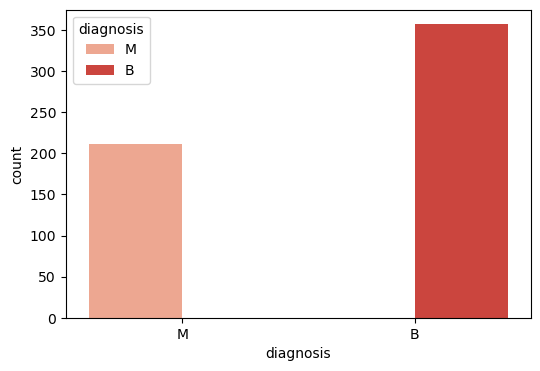

In [13]:

plt.figure(figsize=(6,4))
sns.countplot(x='diagnosis', data=df,  hue='diagnosis', palette='Reds')
plt.show()

### Encodage de la variable Diagnosis

In [14]:
from sklearn.preprocessing import LabelEncoder
labelEncoder_Y= LabelEncoder()

df.iloc[:,0] =labelEncoder_Y.fit_transform(df.iloc[:,0].values)
df.iloc[:,0]

C:\Users\ADMIN\AppData\Local\Temp\ipykernel_7600\1828411404.py:4: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df.iloc[:,0] =labelEncoder_Y.fit_transform(df.iloc[:,0].values)


0      1
1      1
2      1
3      1
4      1
      ..
564    1
565    1
566    1
567    1
568    0
Name: diagnosis, Length: 569, dtype: int32

Desormais la variable Maligne seraa désigné par 1 et la varibale Bénine sera désigné par 0

### Anlyse Bivarié


#### Visualons les pairplots

In [53]:
sns.pairplot (df.iloc[:,0:30], hue ='diagnosis')

### Correlation entre les variables

Nous allons affiché le tableau de corrélation entre les differente svariables

In [16]:
corr = df.corr()
corr

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
diagnosis,1.000000,0.730029,0.415185,0.742636,0.708984,0.358560,0.596534,0.696360,0.776614,0.330499,...,0.776454,0.456903,0.782914,0.733825,0.421465,0.590998,0.659610,0.793566,0.416294,0.323872
radius_mean,0.730029,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,...,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.415185,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,...,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
perimeter_mean,0.742636,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,...,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
area_mean,0.708984,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,...,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
smoothness_mean,0.358560,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,...,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.596534,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,...,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.696360,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,...,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.776614,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,...,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661
symmetry_mean,0.330499,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,...,0.185728,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413


Le tableau étant trop grand pour une analye nous allons plutot passé aux relation target-variables explicatives

In [17]:
correlation_matrix = df.corr()
diagnosis_correlation = correlation_matrix['diagnosis'].sort_values(ascending=False)
print(diagnosis_correlation)

diagnosis                  1.000000
concave points_worst       0.793566
perimeter_worst            0.782914
concave points_mean        0.776614
radius_worst               0.776454
perimeter_mean             0.742636
area_worst                 0.733825
radius_mean                0.730029
area_mean                  0.708984
concavity_mean             0.696360
concavity_worst            0.659610
compactness_mean           0.596534
compactness_worst          0.590998
radius_se                  0.567134
perimeter_se               0.556141
area_se                    0.548236
texture_worst              0.456903
smoothness_worst           0.421465
symmetry_worst             0.416294
texture_mean               0.415185
concave points_se          0.408042
smoothness_mean            0.358560
symmetry_mean              0.330499
fractal_dimension_worst    0.323872
compactness_se             0.292999
concavity_se               0.253730
fractal_dimension_se       0.077972
symmetry_se               -0

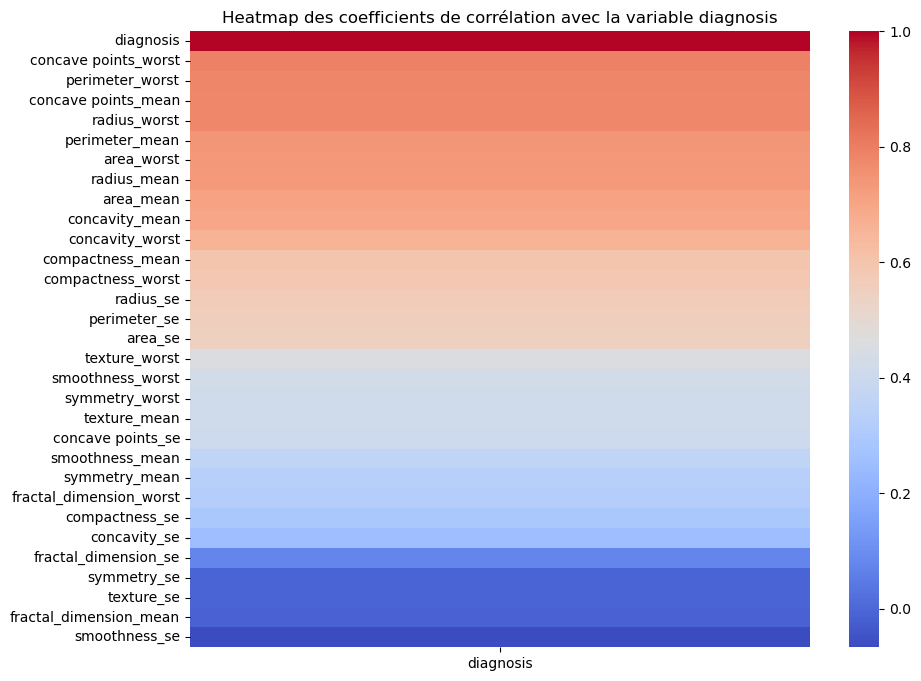

In [18]:
correlation_matrix = df.corr()

# Extraire les coefficients de corrélation de la variable 'diagnosis'
diagnosis_correlation = correlation_matrix[['diagnosis']].sort_values(by='diagnosis', ascending=False)

# Créer une heatmap sans afficher les valeurs
plt.figure(figsize=(10, 8))
sns.heatmap(diagnosis_correlation, annot=False, cmap='coolwarm', cbar=True)

plt.title('Heatmap des coefficients de corrélation avec la variable diagnosis')
plt.show()

Nous allons supprimer les variable symetrie_se et texture_se du data etant donnée leur faible depandance avec la target. La taille des données sera reduite sans pour autant influencé le resultat.

In [21]:
# Supprimer les colonnes 'symmetry_se' et 'texture_se'
df_reduced = df.drop(columns=['symmetry_se', 'texture_se'])


In [24]:
df_reduced.shape

(569, 29)

### Model KNN

In [33]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler

Creeons une variable y qui contiendra la target et une variable x qui contiendra les  variables explicatives

In [57]:
# Séparer les variables explicatives (features) et la variable cible (target)
x = df_reduced.drop(columns=['diagnosis'])
y = df_reduced['diagnosis']

# Vérifier les dimensions des nouveaux DataFrames
print("Dimensions de X:", X.shape)
print("Dimensions de y:", y.shape)


Dimensions de X: (569, 28)
Dimensions de y: (569,)


Scindons le dataset en deux , un train_set sur lequel sera entrainé le model et un test_set sur lequel il sera testé



In [58]:
x_train, x_test,y_train,y_test = train_test_split(x,y,test_size=0.2) 

In [59]:
model = KNeighborsClassifier(n_neighbors=3)
model.fit (x_train,y_train)
print('Train score:' ,model.score (x_train , y_train))
print('Test score:' ,model.score (x_test , y_test))

AttributeError: 'Flags' object has no attribute 'c_contiguous'

Appliquons une normalisation

In [60]:
# Normaliser les caractéristiques
scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_test = scaler.transform(x_test)

# Créer et entraîner le modèle KNeighborsClassifier
for n in range(1, 12):
    model = KNeighborsClassifier(n_neighbors=n)
    model.fit(x_train, y_train)
    
    train_score = model.score(x_train, y_train)
    test_score = model.score(x_test, y_test)
    
    print(f'n_neighbors={n}')
    print('Train score:', train_score)
    print('Test score:', test_score)
    print('---------------------------')

n_neighbors=1
Train score: 1.0
Test score: 0.9824561403508771
---------------------------
n_neighbors=2
Train score: 0.967032967032967
Test score: 0.9649122807017544
---------------------------
n_neighbors=3
Train score: 0.9802197802197802
Test score: 0.9824561403508771
---------------------------
n_neighbors=4
Train score: 0.9692307692307692
Test score: 0.9824561403508771
---------------------------
n_neighbors=5
Train score: 0.9714285714285714
Test score: 0.9912280701754386
---------------------------
n_neighbors=6
Train score: 0.9736263736263736
Test score: 0.9824561403508771
---------------------------
n_neighbors=7
Train score: 0.9714285714285714
Test score: 0.9824561403508771
---------------------------
n_neighbors=8
Train score: 0.9692307692307692
Test score: 0.9824561403508771
---------------------------
n_neighbors=9
Train score: 0.9736263736263736
Test score: 0.9824561403508771
---------------------------
n_neighbors=10
Train score: 0.9648351648351648
Test score: 0.9824561403

#### Note
fit_transform : ajuste le scaler sur les données d'entraînement (calculant la moyenne et l'écart-type) et transforme les données d'entraînement.

transform : utilise les mêmes paramètres (moyenne et écart-type) pour transformer les données de test afin d'assurer que les données d'entraînement et de test sont normalisées de la même manière.
### Remarque
En faisant varier les valeur de n(=_neighbord on remarque une différence entre les score .


## Procedons à une cross validation


In [65]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import validation_curve

In [69]:
# Définir les valeurs de n_neighbors à tester
param_range = np.arange(1, 50)
# Utiliser validation_curve pour obtenir les scores
train_scores, test_scores = validation_curve(
    KNeighborsClassifier(),
    x_train,
    y_train,
    param_name='n_neighbors',
    param_range=param_range,
    cv=5,
    scoring='accuracy'
)

# Afficher les résultats
print("n_neighbors | Train Score | Validation Score")
print("--------------------------------------------")
for i in range(len(param_range)):
    print(f"{param_range[i]}           | {np.mean(train_scores[i]):.4f}    | {np.mean(test_scores[i]):.4f}")

n_neighbors | Train Score | Validation Score
--------------------------------------------
1           | 1.0000    | 0.9473
2           | 0.9654    | 0.9538
3           | 0.9780    | 0.9538
4           | 0.9698    | 0.9560
5           | 0.9703    | 0.9560
6           | 0.9692    | 0.9516
7           | 0.9687    | 0.9495
8           | 0.9643    | 0.9473
9           | 0.9681    | 0.9495
10           | 0.9621    | 0.9451
11           | 0.9610    | 0.9473
12           | 0.9555    | 0.9385
13           | 0.9577    | 0.9451
14           | 0.9577    | 0.9451
15           | 0.9588    | 0.9516
16           | 0.9549    | 0.9473
17           | 0.9544    | 0.9495
18           | 0.9522    | 0.9473
19           | 0.9538    | 0.9560
20           | 0.9533    | 0.9538
21           | 0.9571    | 0.9495
22           | 0.9549    | 0.9473
23           | 0.9593    | 0.9473
24           | 0.9560    | 0.9451
25           | 0.9560    | 0.9451
26           | 0.9544    | 0.9451
27           | 0.9538    | 0.9451
2

In [70]:
meilleur_score = np.argmax(val_score)
print ('On obient la meilleur perfomance pour un nombre de voisin étant de :',meilleur_score ,'le score étant :',val_score[meilleur_score])

On obient la meilleur perfomance pour un nombre de voisin étant de : 4 le score étant : 0.9714285714285713


In [72]:
model = KNeighborsClassifier(n_neighbors=4)
model.fit(x_train, y_train)
    
train_score = model.score(x_train, y_train)
test_score = model.score(x_test, y_test)
    
print(f'n_neighbors={4}')
print('Train score:', train_score)
print('Test score:', test_score)
print('---------------------------')

n_neighbors=4
Train score: 0.9692307692307692
Test score: 0.9824561403508771
---------------------------


#### Essayons d'obtenir de meilleurs performance en utilisant les autre hyperparametre du model

In [74]:
parametre_Grid ={'n_neighbors': np.arange(1,50),'metric':['euclidean','manhattan']}


In [79]:
grid=GridSearchCV(KNeighborsClassifier(),parametre_Grid,cv=5)


In [80]:
grid.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'metric': ['euclidean', 'manhattan'],
                         'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49])})

In [81]:
 grid.best_score_

0.956043956043956

In [82]:
grid.best_params_

{'metric': 'euclidean', 'n_neighbors': 4}

In [83]:
model=grid.best_estimator_

In [84]:
model.score (x_test,y_test)

0.9824561403508771

Les meilleurs performances sont donc obtenue pour un nombre de voisins etant egale à 4 avec une distance euclidienne

In [85]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y_test,model.predict(x_test))

array([[72,  0],
       [ 2, 40]], dtype=int64)